<a href="https://colab.research.google.com/github/suvrashaw/YOLO-Flask/blob/prime/YOLO-Flask.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


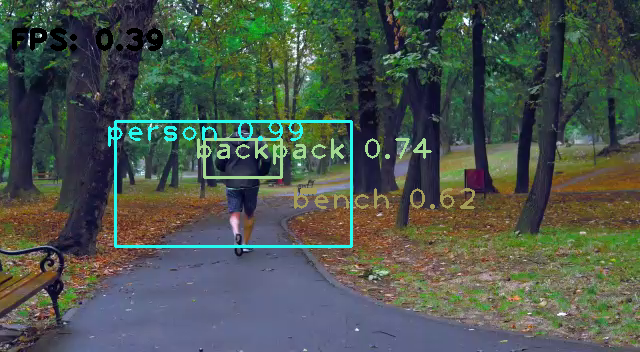

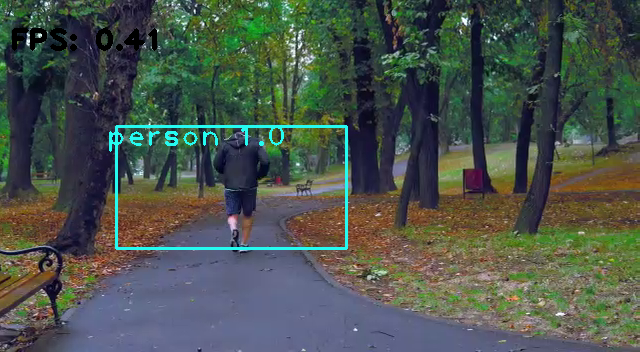

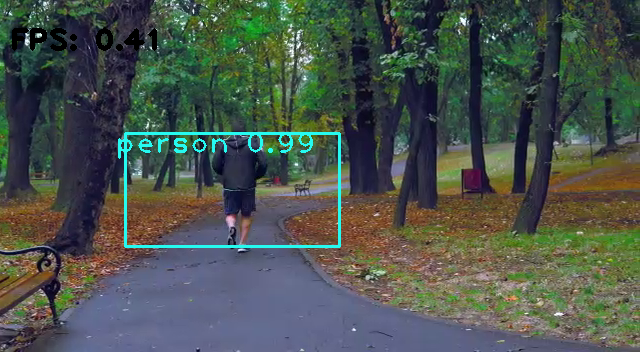

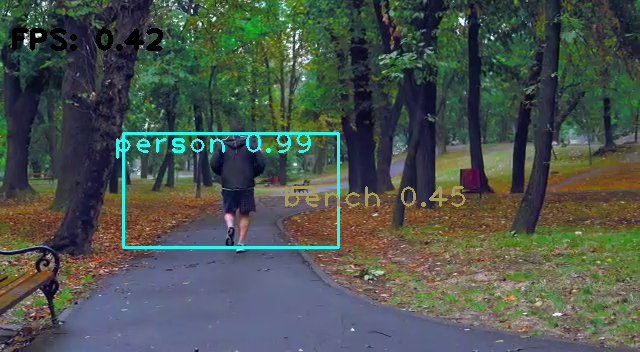

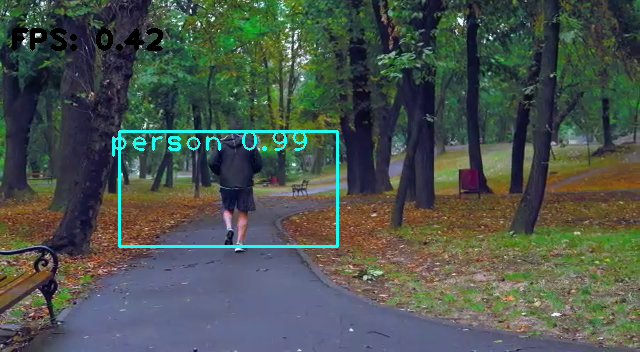

...

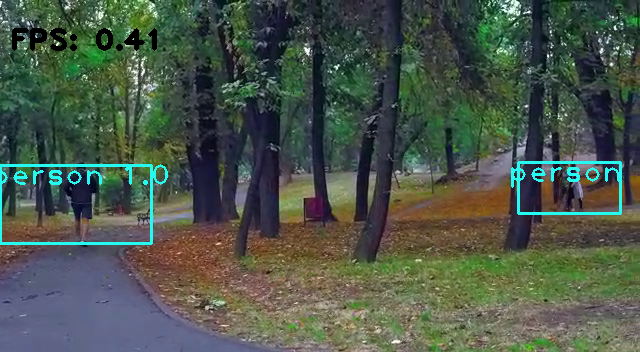

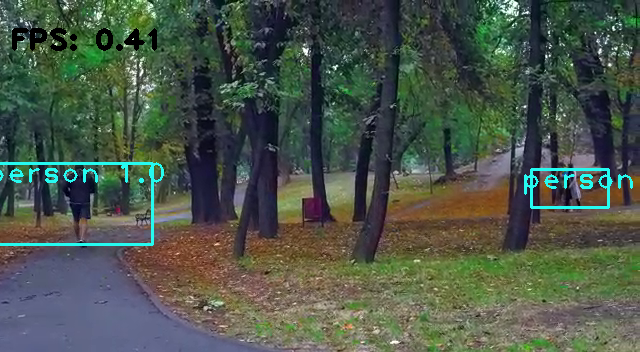

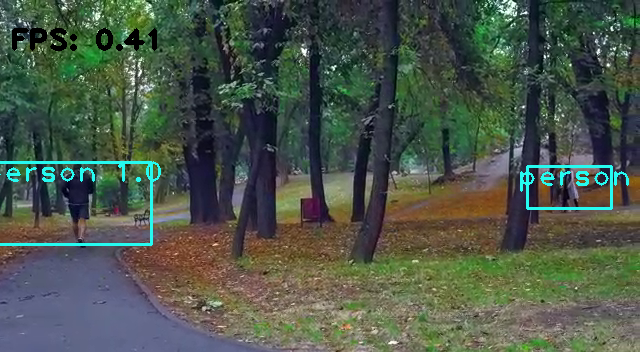

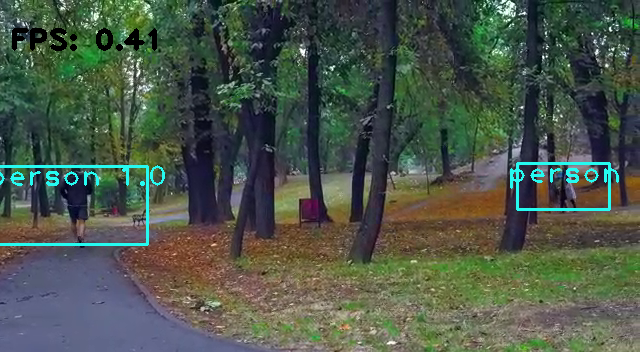

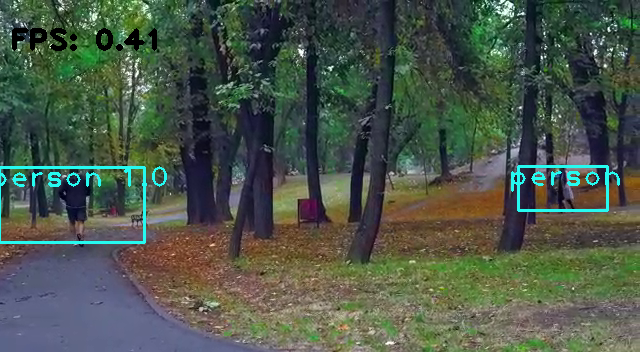

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import numpy as np
import time
from google.colab.patches import cv2_imshow
net = cv2.dnn.readNet("/content/drive/MyDrive/YOLOv3/yolov3.weights", "yolov3.cfg")
with open("coco.names", "r") as f: classes = [line.strip() for line in f.readlines()]
layer_names = net.getLayerNames()
output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))
cap = cv2.VideoCapture("input.mp4")
font = cv2.FONT_HERSHEY_PLAIN
starting_time = time.time()
frame_id = 0
result = cv2.VideoWriter('output.avi', cv2.VideoWriter_fourcc(*'MPEG'),25.0, (640, 352))
while True:
    _, frame = cap.read()
    frame_id += 1
    height, width, channels = frame.shape
    blob = cv2.dnn.blobFromImage(frame, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(output_layers)
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.2:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[3] * width)
                h = int(detection[3] * height)
                x = int(center_x - w / 1.8)
                y = int(center_y - h / 1.8)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)
    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.3)
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            confidence = confidences[i]
            color = colors[class_ids[i]]
            cv2.rectangle(frame, (x+10, y+10), (x + w, y + h), color, 2)
            cv2.putText(frame, label + " " + str(round(confidence, 2)), (x, y + 30), font, 2, color, 2)
    elapsed_time = time.time() - starting_time
    fps = frame_id / elapsed_time
    cv2.putText(frame, "FPS: " + str(round(fps, 2)), (10, 50), font, 2, (0, 0, 0), 3)
    result.write(frame)
    cv2_imshow(frame)
    if cv2.waitKey(1) ==ord('q'):
        break
cap.release()
cv2.destroyAllWindows()